<a href="https://colab.research.google.com/github/Korck-lab/satellite-image-super-resolution/blob/master/notebooks/data_sourcing_and_processing/tif_filtering_post_download.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>


Notebook authors: Elena Gronskaya, Özgün Haznedar

This notebook is used for secondary filtering of images sourced by
tif_exporter_moving_square, to remove HR-LR image pairs where at least one of
the images has cloud content or missing data.

In [ ]:
import gdal
gdal.UseExceptions()
import matplotlib.pyplot as plt
import numpy as np
import os

from google.colab import drive
drive.mount('/content/drive')

In [ ]:
# WRITE DIRECTORY NAME AND RUN THE NEXT CELL

directory = 'DIRECTORY TO IMAGE DATASET'


In [ ]:
# iterate over files in
# that directory
l8_list = list()
s2_list = list()
for filename in os.listdir(directory):
    f = os.path.join(directory, filename)
    # checking if it is a file
    if os.path.isfile(f) and "L8" in f:
      l8_list.append(f)
    elif os.path.isfile(f) and "S2" in f:
      s2_list.append(f)

l8_list.sort()
s2_list.sort()
file_list = list(zip(l8_list,s2_list))

#Function that converts downloaded files to RGB arrays and corrects exposure of images by scaling
def img_array_RGB(filepath , source):
  geotiff = gdal.Open(filepath)
  geotiff_arr = geotiff.ReadAsArray()
  geotiff_arr = geotiff_arr.astype(int)
  rgb_image = np.rollaxis(geotiff_arr,0,3)

  if source == "sentinel":
    rgb_image = ((rgb_image *255/3558)*1.4).astype(int) # sentinel conversion , *1.4 is manual correction
  elif source == "landsat" :
    rgb_image = ((rgb_image*0.0000275-0.2)*255*4).astype(int) # landsat conversion original , *4 is manual correction
    #rgb_image = ((rgb_image*0.0000275-0.2)*255).astype(int) # landsat conversion original

  else:
    print("NO SOURCE SPECIFIED")

  return rgb_image


filtered_image_RGBs = list()
filtered_image_filenames = list()

for landsat_file , sentinel_file in file_list:

  landsat_rgb = img_array_RGB(landsat_file,"landsat")
  landsat_filename = landsat_file[len(directory)+1:]
  sentinel_rgb = img_array_RGB(sentinel_file,"sentinel")
  sentinel_filename = sentinel_file[len(directory)+1:]

  low_threshold = 0
  low_percentile = 5
  high_threshold = 200
  high_percentile = 99

  if np.percentile(landsat_rgb[:,0,0],low_percentile)> low_threshold and \
     np.percentile(landsat_rgb[0,:,0],low_percentile)> low_threshold and \
     np.percentile(landsat_rgb[0,0,:],low_percentile)> low_threshold and \
     np.percentile(sentinel_rgb[:,0,0],low_percentile)> low_threshold and \
     np.percentile(sentinel_rgb[0,:,0],low_percentile)> low_threshold and \
     np.percentile(sentinel_rgb[0,0,:],low_percentile)> low_threshold and \
     np.percentile(landsat_rgb[:,0,0],high_percentile)< high_threshold and \
     np.percentile(landsat_rgb[0,:,0],high_percentile)< high_threshold and \
     np.percentile(landsat_rgb[0,0,:],high_percentile)< high_threshold and \
     np.percentile(sentinel_rgb[:,0,0],high_percentile)< high_threshold and \
     np.percentile(sentinel_rgb[0,:,0],high_percentile)< high_threshold and \
     np.percentile(sentinel_rgb[0,0,:],high_percentile)< high_threshold:
     filtered_image_RGBs.append([[landsat_rgb,landsat_file],[sentinel_rgb,sentinel_file]])
     filtered_image_filenames.append(landsat_filename)
     filtered_image_filenames.append(sentinel_filename)


In [ ]:
# delete all files that do not meet filter criteria

file_list=np.array(os.listdir(directory))

for filename in file_list:
  if filename not in filtered_image_filenames:
    os.remove(os.path.join(directory, filename))


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


0


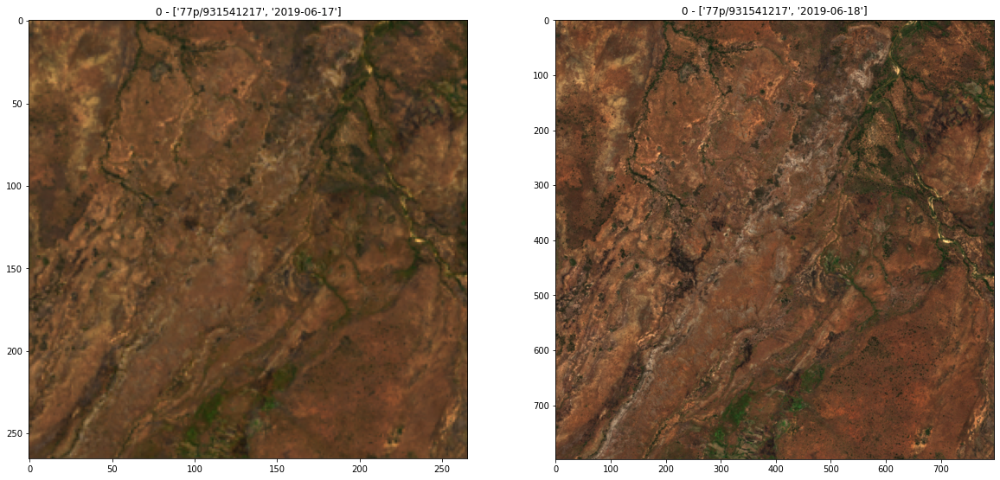

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1


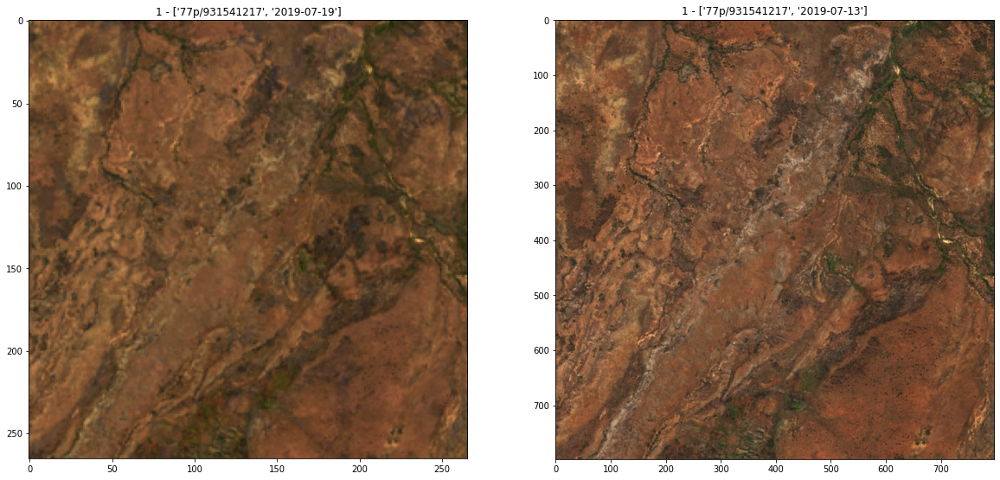

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2


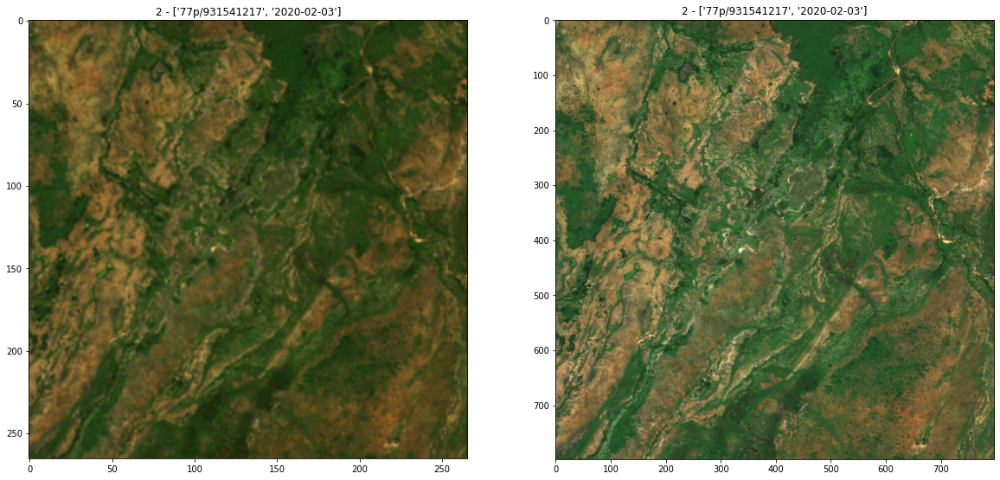

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


3


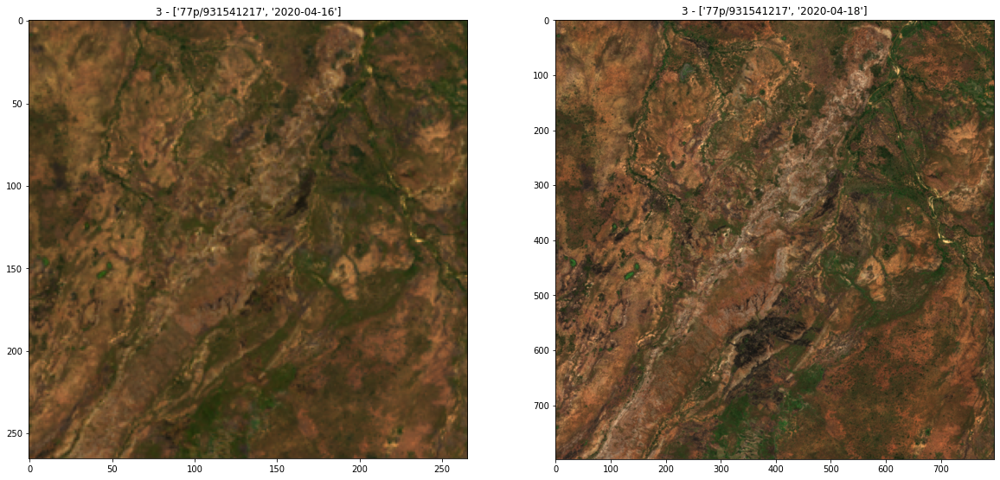

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4


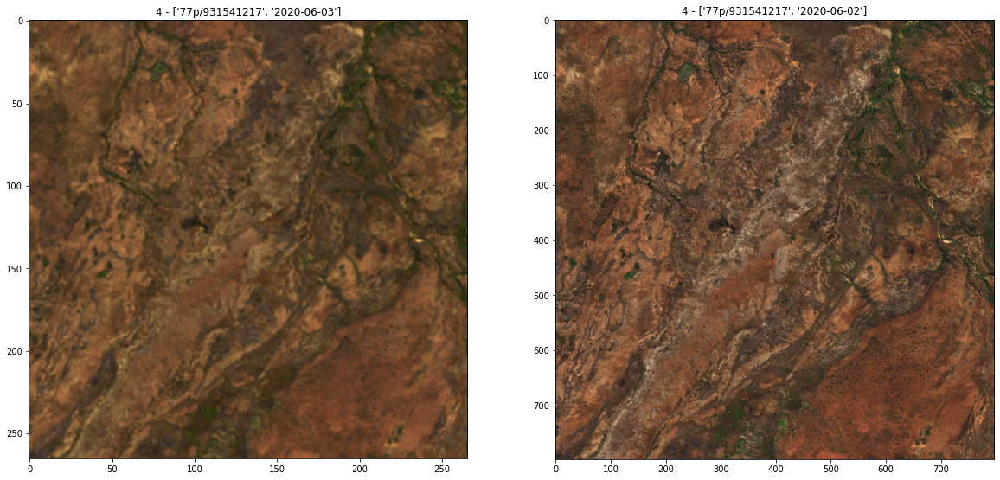

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5


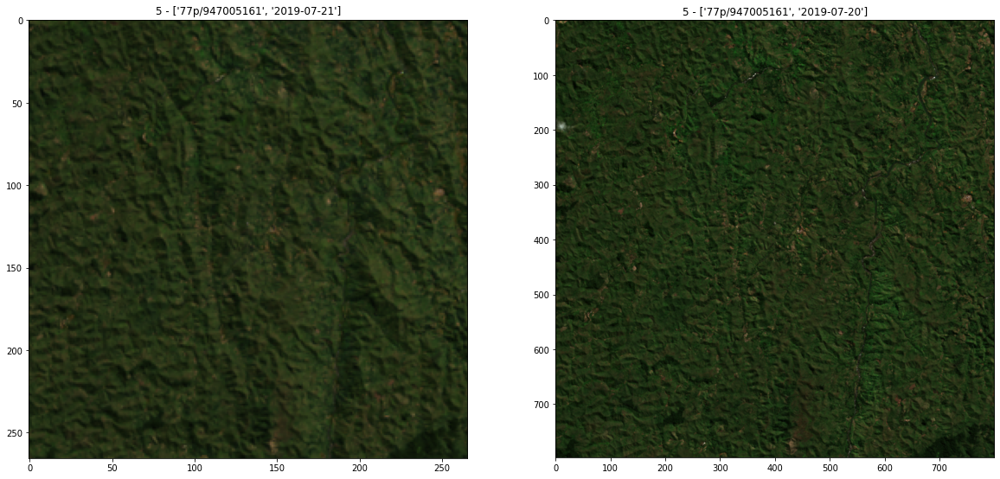

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


6


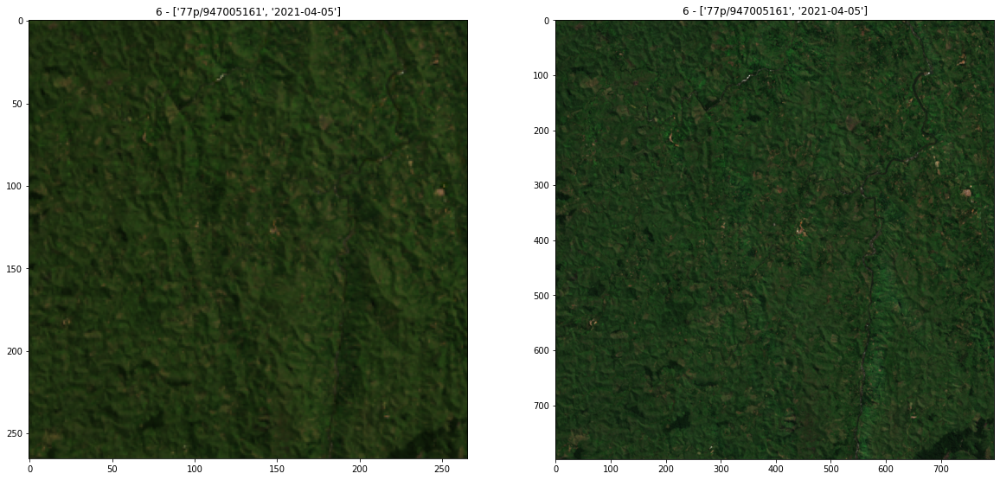

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


7


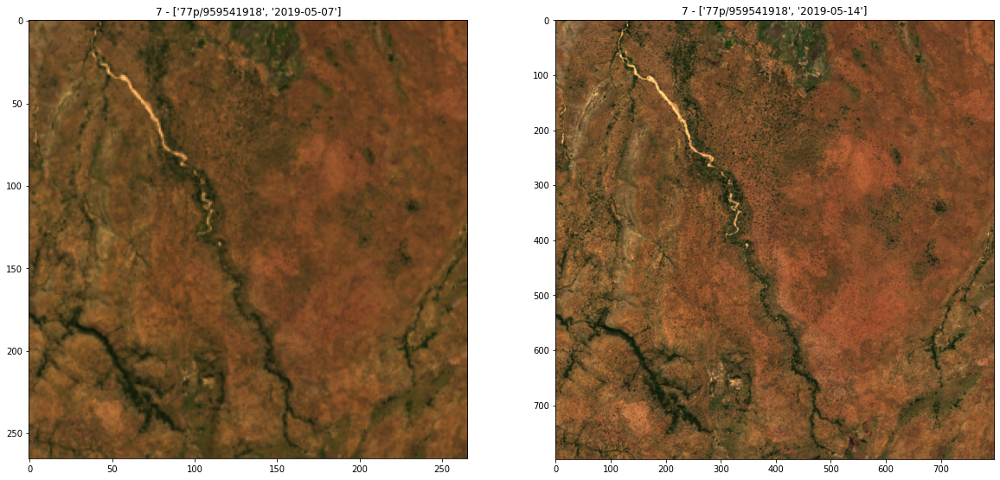

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


8


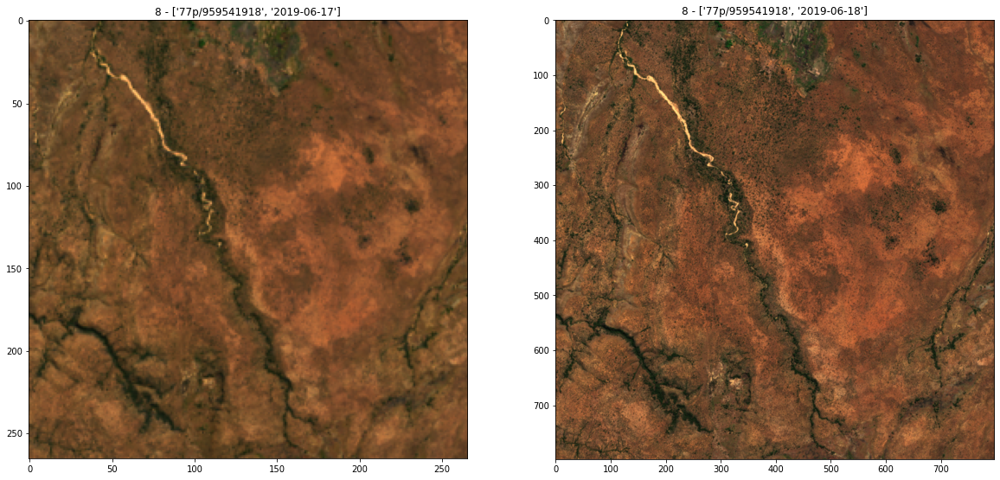

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


9


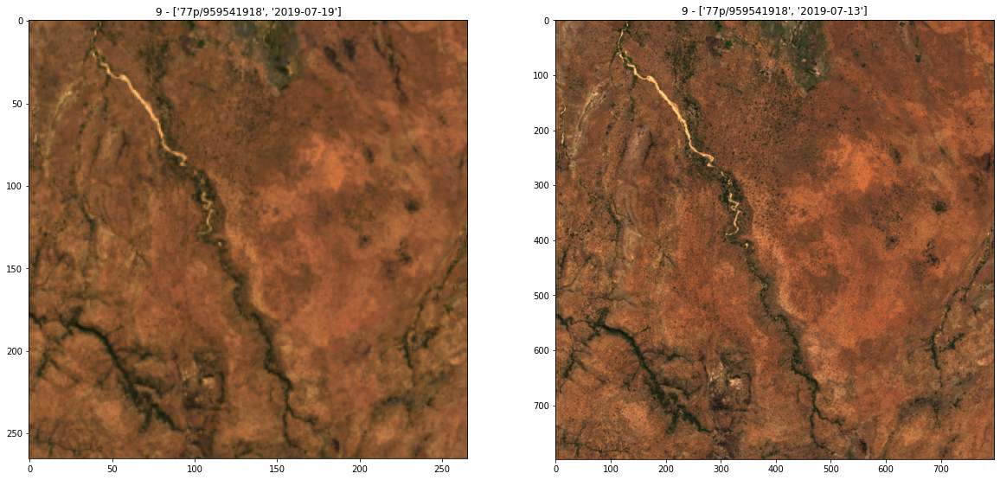

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


10


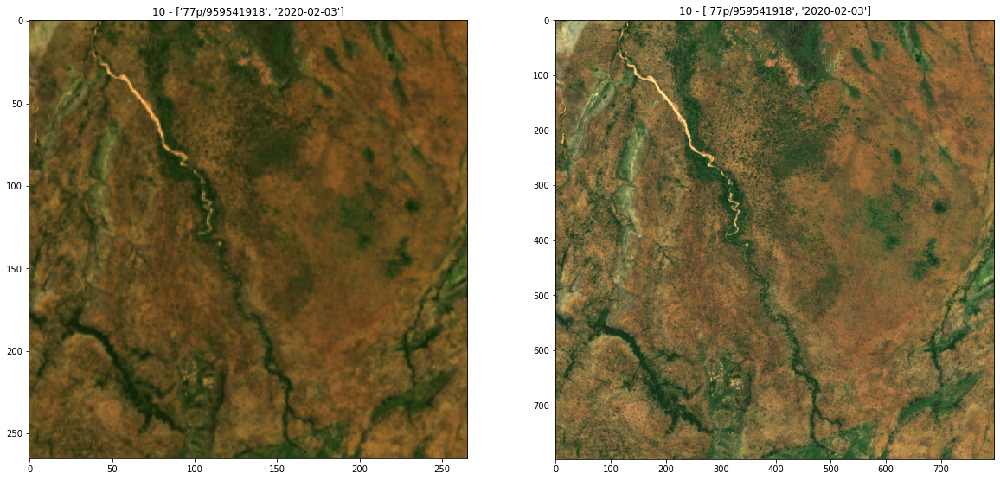

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


11


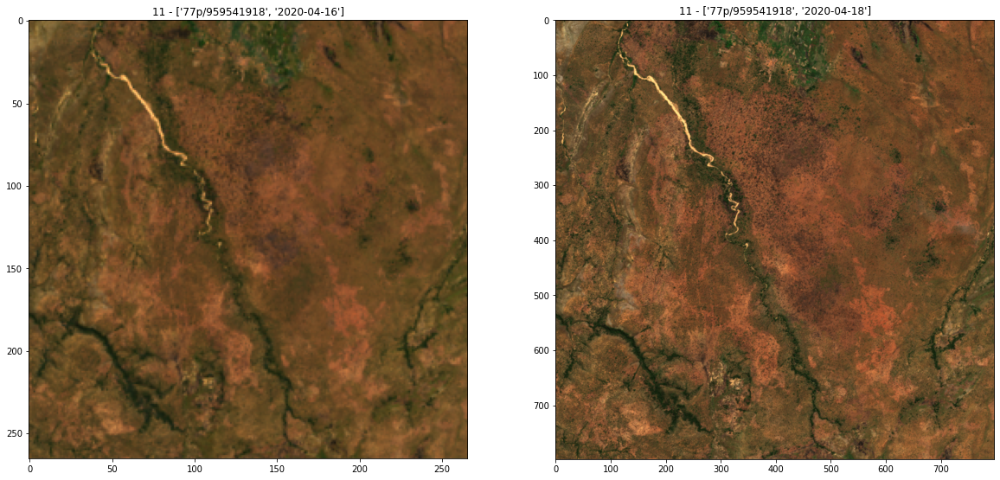

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


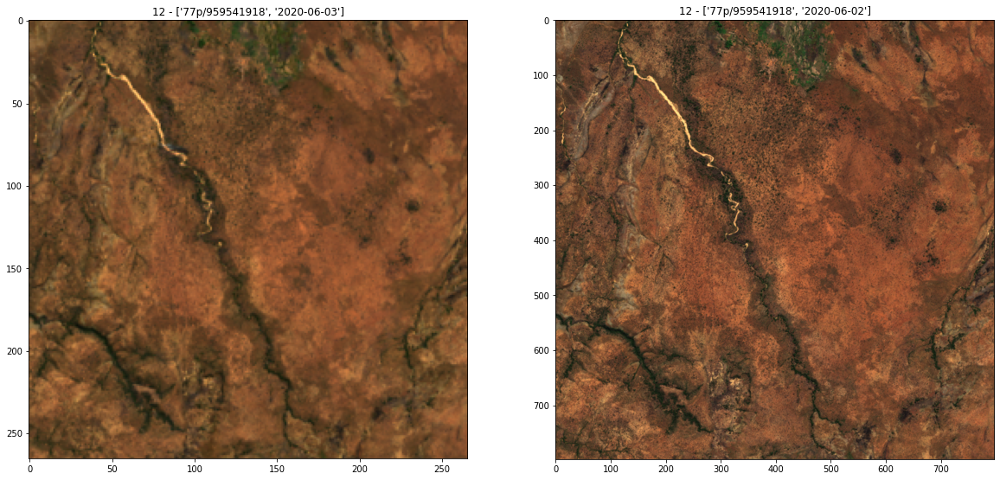

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


13


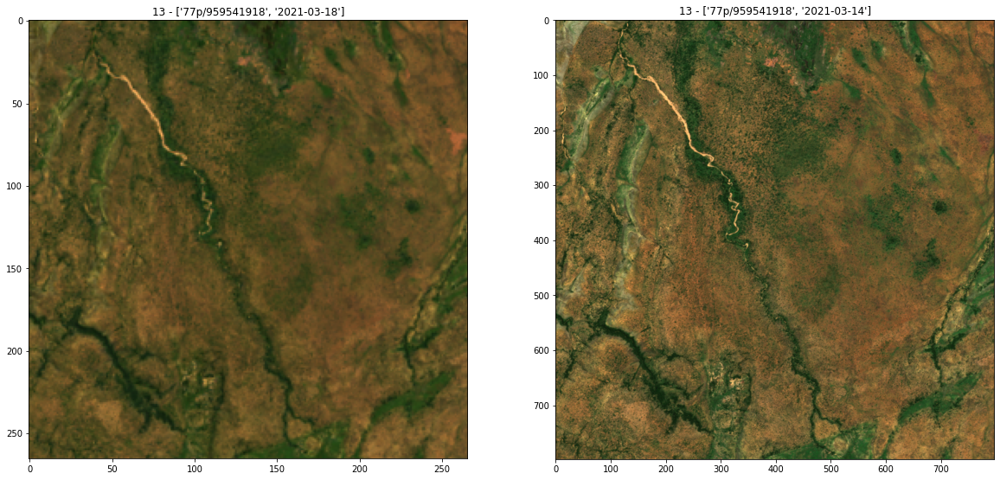

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


14


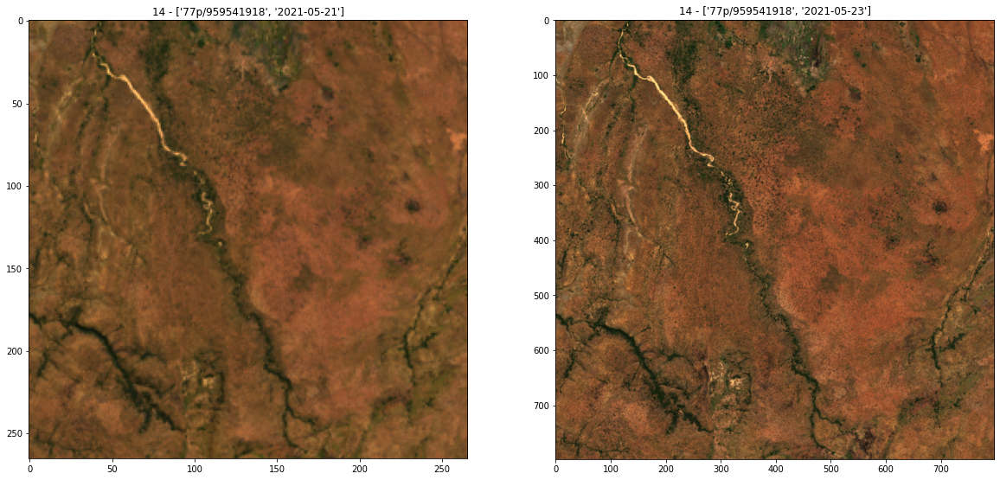

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


15


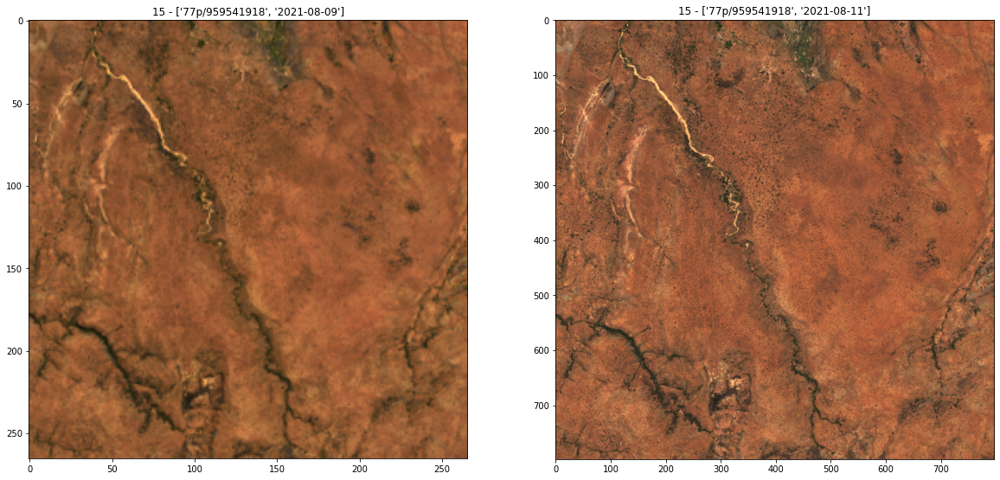

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


16


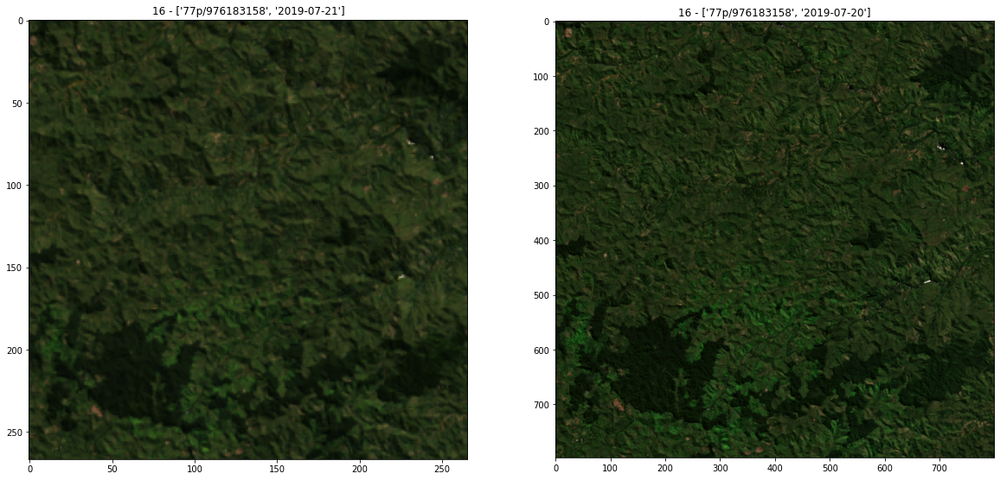

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


17


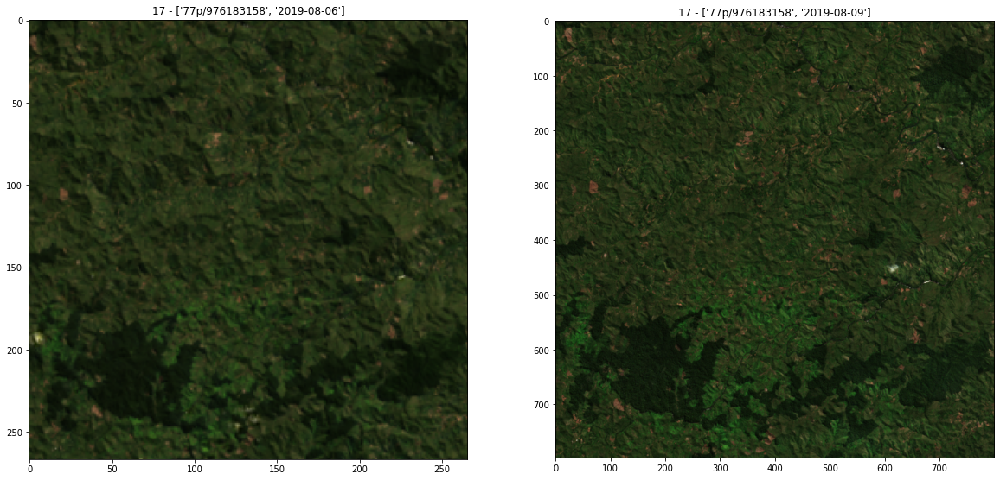

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


18


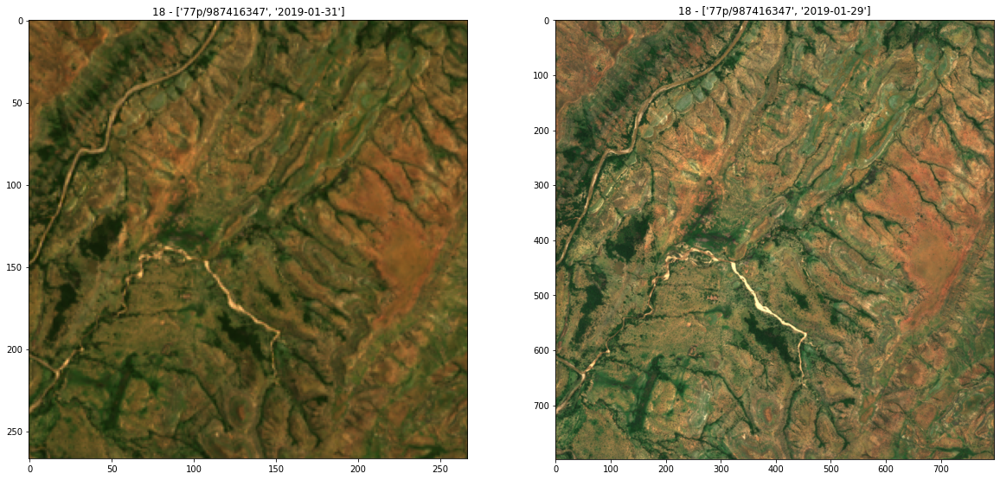

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


19


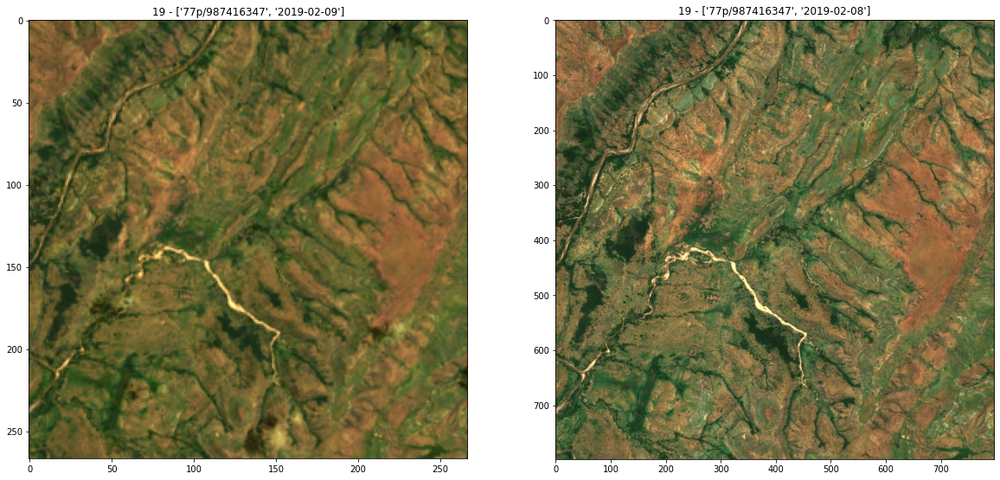

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


20


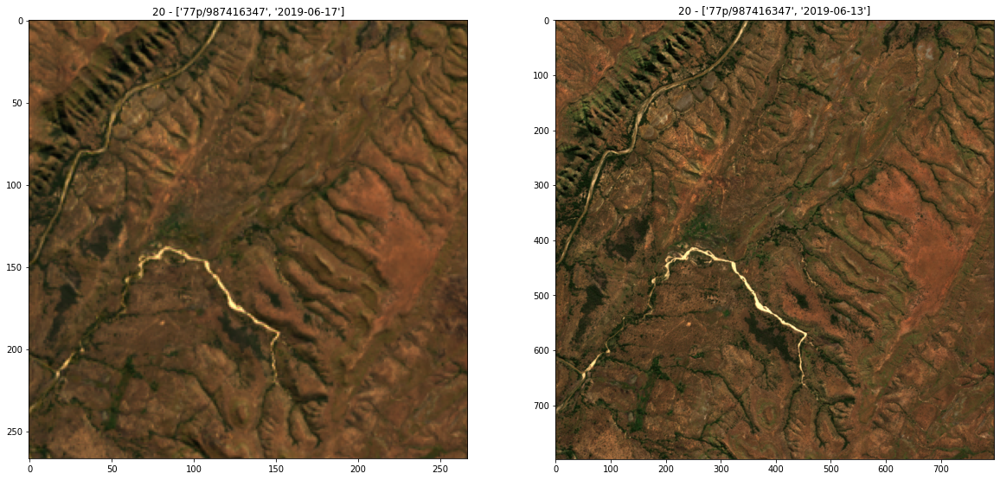

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


21


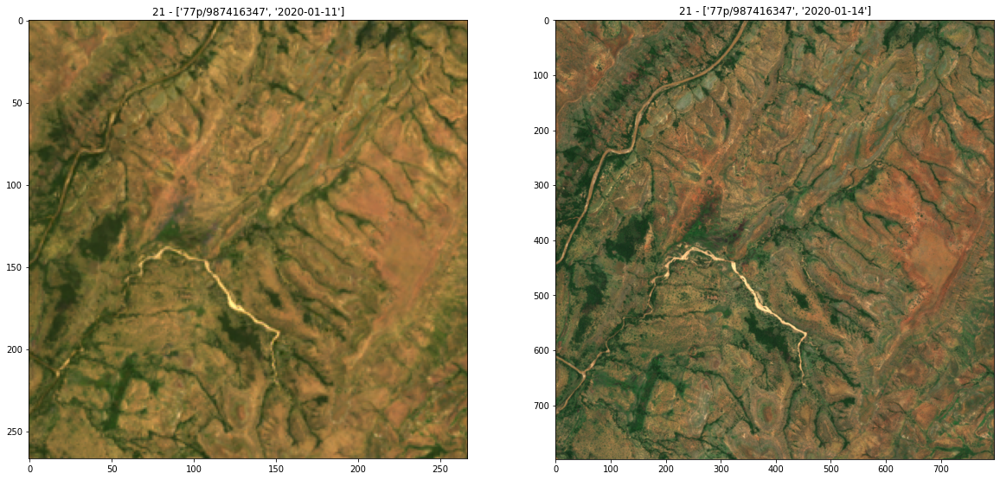

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


22


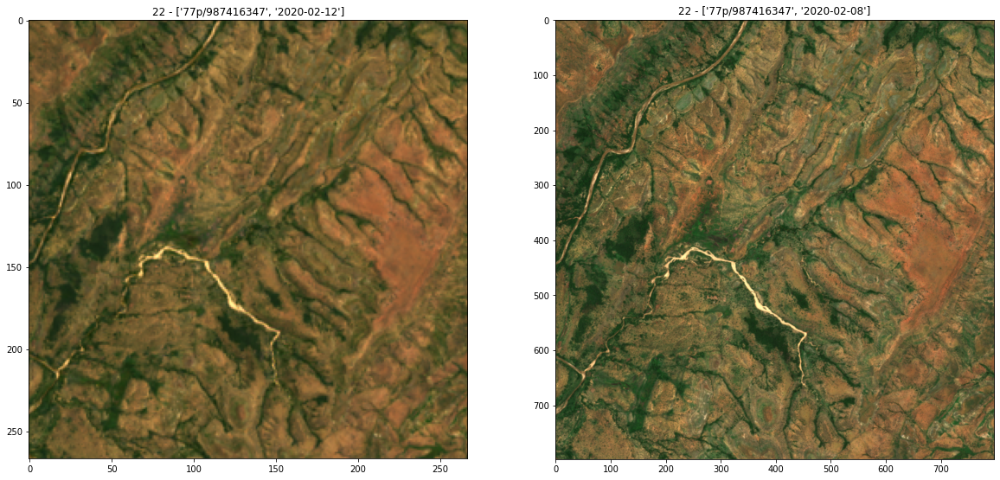

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


23


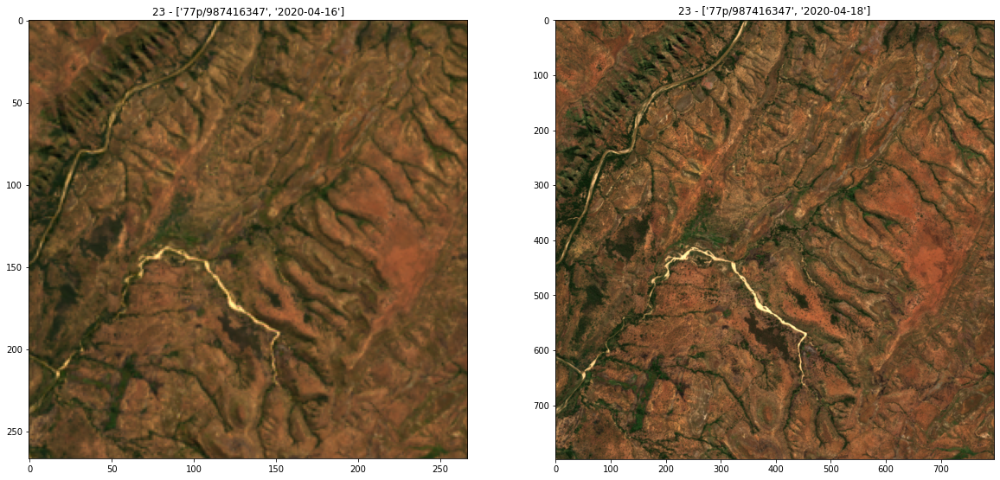

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


24


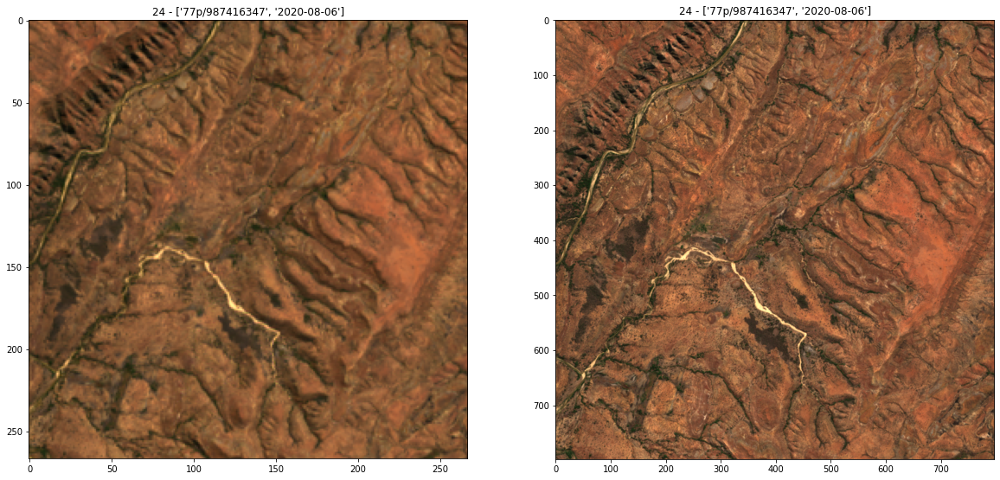

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


25


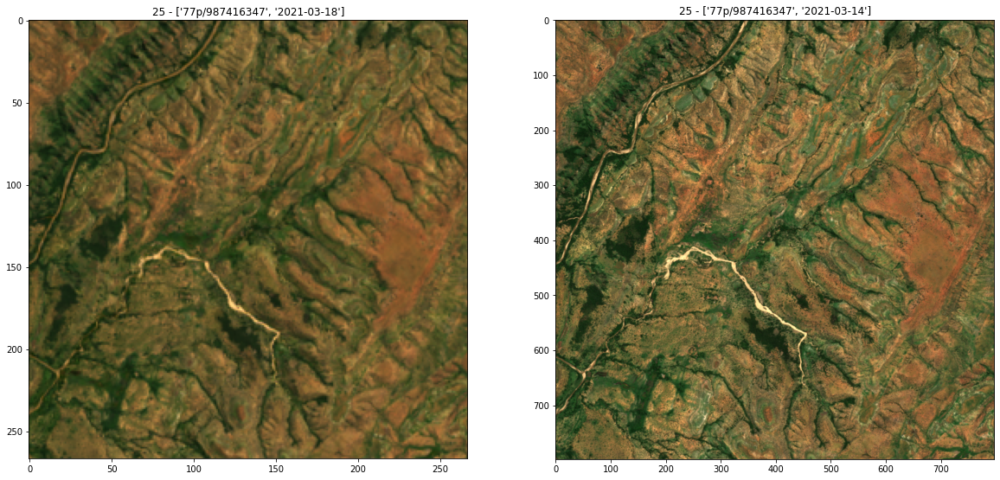

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


26


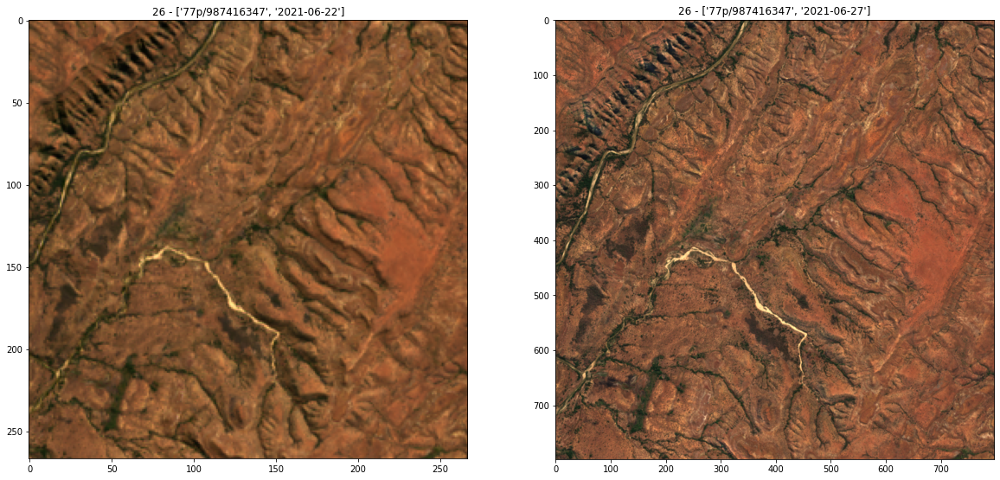

In [ ]:
#Plot the images pairwise
for idx , image in enumerate(filtered_image_RGBs[50:]):
  fig, ax = plt.subplots(1,2,figsize=(20,20))

  ax[0].imshow(image[0][0])
  ax[0].set_title(f"{idx} - {image[0][1].split('_')[4:6]}")
  #ax[0].set_title(f"Landsat -  5th percintile RGB values : {np.percentile(image[0][0][:,0,0],5)} ,{np.percentile(image[0][0][0,:,0],5)} , {np.percentile(image[0][0][0,0,:],5)}")
  print(idx)

  ax[1].imshow(image[1][0])
  ax[1].set_title(f"{idx} - {image[1][1].split('_')[4:6]}")
  #ax[1].set_title(f"Sentinel -  5th percintile RGB values : {np.percentile(image[1][0][:,0,0],5)} ,{np.percentile(image[1][0][0,:,0],5)} , {np.percentile(image[1][0][0,0,:],5)}")

  plt.show()